In [2]:
# !/usr/bin/nev python
# -*-coding:utf8-*-


from datetime import datetime
from requests_html import HTMLSession
import re, time
import tkinter as tk
import urllib3                      # 解除警告
urllib3.disable_warnings()
session = HTMLSession()


class WBSpider(object):

    def __init__(self):

        """定义可视化窗口，并设置窗口和主题大小布局"""
        self.window = tk.Tk()
        self.window.title('微博评论信息采集')
        self.window.geometry('800x600')

        """创建label_user按钮，与说明书"""
        self.label_user = tk.Label(self.window, text='请输入要爬取的微博评论的地址：', font=('Arial', 12), width=30, height=2)
        self.label_user.pack()
        """创建label_user关联输入"""
        self.entry_user = tk.Entry(self.window, show=None, font=('Arial', 14))
        self.entry_user.pack(after=self.label_user)

        """创建label_passwd按钮，与说明书"""
        self.label_passwd = tk.Label(self.window, text="请输入登陆后的cookie：", font=('Arial', 12), width=30, height=2)
        self.label_passwd.pack()
        """创建label_passwd关联输入"""
        self.entry_passwd = tk.Entry(self.window, show=None, font=('Arial', 14))
        self.entry_passwd.pack(after=self.label_passwd)

        """创建Text富文本框，用于按钮操作结果的展示"""
        self.text1 = tk.Text(self.window, font=('Arial', 12), width=85, height=22)
        self.text1.pack()

        """定义按钮1，绑定触发事件方法"""

        self.button_1 = tk.Button(self.window, text='爬取', font=('Arial', 12), width=10, height=1,
                                  command=self.parse_hit_click_1)
        self.button_1.pack(before=self.text1)

        """定义按钮2，绑定触发事件方法"""
        self.button_2 = tk.Button(self.window, text='清除', font=('Arial', 12), width=10, height=1,
                                  command=self.parse_hit_click_2)
        self.button_2.pack(anchor="e")



    def parse_hit_click_1(self):
        """定义触发事件1,调用main函数"""
        user_url = self.entry_user.get()
        pass_wd = self.entry_passwd.get()
        self.main(user_url, pass_wd)


    def main(self, user_url, pass_wd):
        i = 1

        headers_1 = {
            'cookie': pass_wd,
            'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.101 Safari/537.36'

        }
        headers_2 ={
            "referer": "https://m.weibo.cn/status/Kk9Ft0FIg?jumpfrom=weibocom",
            'cookie': pass_wd,
            'user-agent': 'Mozilla/5.0 (Linux; Android 6.0; Nexus 5 Build/MRA58N) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.101 Mobile Safari/537.36'
        }
        uid_1 = re.findall('/(.*?)#', user_url)[0]
        uid_2 = uid_1.split('/', 3)[3]
        # print(uid_2)

        url_1 = f'https://weibo.com/ajax/statuses/show?id={uid_2}'
        prox = ''
        response = session.get(url_1, proxies={'http': prox, 'https': prox}, headers=headers_1, verify=False).content.decode()
        # print(response)
        weibo_id = re.findall('"id":(.*?),"idstr"', response)[0]
        # print(weibo_id)
        # 构造起始地址
        start_url = f'https://m.weibo.cn/comments/hotflow?id={weibo_id}&mid={weibo_id}&max_id_type=0'
        """
                2.发送请求，获取响应：解析起始的url地址
                :return:
                """
        prox = ''
        response = session.get(start_url, proxies={'http': prox, 'https': prox}, headers=headers_2, verify=False).json()

        """提取翻页的max_id"""
        max_id = response['data']['max_id']
        """提取翻页的max_id_type"""
        max_id_type = response['data']['max_id_type']

        """构造GET请求参数"""
        data = {
            'id': weibo_id,
            'mid': weibo_id,
            'max_id': max_id,
            'max_id_type': max_id_type
        }
        """解析评论内容"""
        self.parse_response_data(response, i)
        i+=1
        """参数传递，方法回调"""
        self.parse_page_func(data, weibo_id, headers_2, i)

    def parse_page_func(self, data, weibo_id, headers_2, i):
        """
        :return:
        """

        start_url = 'https://m.weibo.cn/comments/hotflow?'
        prox = ''
        response = session.get(start_url, proxies={'http': prox, 'https': prox}, headers=headers_2, params=data, verify=False).json()
        """提取翻页的max_id"""
        max_id = response['data']['max_id']
        """提取翻页的max_id_type"""
        max_id_type = response['data']['max_id_type']
        """构造GET请求参数"""
        data = {
            'id': weibo_id,
            'mid': weibo_id,
            'max_id': max_id,
            'max_id_type': max_id_type
        }
        """解析评论内容"""
        self.parse_response_data(response, i)
        i+=1
        """递归回调"""
        self.parse_page_func(data, weibo_id, headers_2, i)

    def parse_response_data(self, response, i):
        """
        从响应中提取评论内容
        :return:
        """
        """提取出评论大列表"""
        data_list = response['data']['data']
        # print(data_list)
        for data_json_dict in data_list:
            # 提取评论内容
            try:
                texts_1 = data_json_dict['text']
                """需要sub替换掉标签内容"""
                # 需要替换的内容，替换之后的内容，替换对象
                alts = ''.join(re.findall(r'alt=(.*?) ', texts_1))
                texts = re.sub("<span.*?</span>", alts, texts_1)
                # 点赞量
                like_counts = str(data_json_dict['like_count'])
                # 评论时间   格林威治时间---需要转化为北京时间
                created_at = data_json_dict['created_at']
                std_transfer = '%a %b %d %H:%M:%S %z %Y'
                std_create_times = str(datetime.strptime(created_at, std_transfer))
                # 性别  提取出来的是  f
                gender = data_json_dict['user']['gender']
                genders = '女' if gender == 'f' else '男'
                # 用户名
                screen_names = data_json_dict['user']['screen_name']

                print(screen_names, genders, std_create_times, texts, like_counts)
                print()
            except Exception as e:
                continue
        print('*******************************************************************************************')
        print()
        print(f'*****第{i}页评论打印完成*****')


    def parse_hit_click_2(self):
        """定义触发事件2，删除文本框中内容"""
        self.entry_user.delete(0, "end")
        self.entry_passwd.delete(0, "end")
        self.text1.delete("1.0", "end")

    def center(self):
        """创建窗口居中函数方法"""
        ws = self.window.winfo_screenwidth()
        hs = self.window.winfo_screenheight()
        x = int((ws / 2) - (800 / 2))
        y = int((hs / 2) - (600 / 2))
        self.window.geometry('{}x{}+{}+{}'.format(800, 600, x, y))

    def run_loop(self):
        """禁止修改窗体大小规格"""
        self.window.resizable(False, False)
        """窗口居中"""
        self.center()
        """窗口维持--持久化"""
        self.window.mainloop()



if __name__ == '__main__':
    w = WBSpider()
    w.run_loop()

In [3]:
import requests
import pandas as pd
import json

page_num = 0

def get_content_1(uid, mid, the_first=True, max_id=None):
   cookies = {
       'SINAGLOBAL': '1278126679099.0298.1694199077980',
       'SUBP': '0033WrSXqPxfM725Ws9jqgMF55529P9D9W5mzQcPEhHvorRG-l7.BSsy5JpX5KMhUgL.FoM7ehz4eo2p1h52dJLoI0qLxK-LBKBLBKMLxKnL1--L1heLxKnL1-qLBo.LxK-L1KeL1KzLxK-L1KeL1KzLxK-L1KeL1Kzt',
       'XSRF-TOKEN': 'F2EEQZrINBfzB2HPPxqTMQJ_',
       'ALF': '1697089355',
       'SSOLoginState': '1694497354',
       'SCF': 'ApDYB6ZQHU_wHU8ItPHSso29Xu0ZRSkOOiFTBeXETNm72ymhw36b_mHClr0ewNZN4ShIPpOcL0IcsUXxdc8Hjcc.',
       'SUB': '_2A25J-4obDeRhGeFO61AY8i_NwzyIHXVrcPzTrDV8PUNbmtAGLW7NkW9NQYCXlkwnjDGcFQsKW0YQuGxnZHHUKcwL',
       '_s_tentry': 'weibo.com',
       'Apache': '9940157047236.127.1694497456654',
       'ULV': '1694497456684:5:5:1:9940157047236.127.1694497456654:1694273044323',
       'WBPSESS': 'X5DJqu8gKpwqYSp80b4XokKvi4u4_oikBqVmvlBCHvGwXMxtKAFxIPg-LIF7foS715Sa4NttSYqzj5x2Ms5ynFwkvQws-CZ4L-m6NLVjmDKUuHrZR3UM90hhPWHorFbkpQx1WZuZ2yCA73LeWLQYNA==',
   }

   headers = {
       'authority': 'weibo.com',
       'accept': 'application/json, text/plain, */*',
       'accept-language': 'zh-CN,zh;q=0.9,en;q=0.8,en-GB;q=0.7,en-US;q=0.6',
       'client-version': 'v2.43.30',
       'referer': 'https://weibo.com/1762257041/NiSAxfmbZ',
       'sec-ch-ua': '"Chromium";v="116", "Not)A;Brand";v="24", "Microsoft Edge";v="116"',
       'sec-ch-ua-mobile': '?0',
       'sec-ch-ua-platform': '"Windows"',
       'sec-fetch-dest': 'empty',
       'sec-fetch-mode': 'cors',
       'sec-fetch-site': 'same-origin',
       'server-version': 'v2023.09.08.4',
       'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/116.0.0.0 Safari/537.36 Edg/116.0.1938.69',
       'x-requested-with': 'XMLHttpRequest',
       'x-xsrf-token': 'F2EEQZrINBfzB2HPPxqTMQJ_',
   }
   
   params = {
       'is_reload': '1',
       'id': f'{mid}',
       'is_show_bulletin': '2',
       'is_mix': '0',
       'count': '20',
       'uid': f'{uid}',
       'fetch_level': '0',
       'locale': 'zh-CN',
   }

   if not the_first:
       params['flow'] = 0
       params['max_id'] = max_id
   else:
       pass
   response = requests.get('https://weibo.com/ajax/statuses/buildComments', params=params, cookies=cookies, headers=headers)
   return response

def get_content_2(get_content_1_url):
   cookies = {
       'SINAGLOBAL': '1278126679099.0298.1694199077980',
       'SUBP': '0033WrSXqPxfM725Ws9jqgMF55529P9D9W5mzQcPEhHvorRG-l7.BSsy5JpX5KMhUgL.FoM7ehz4eo2p1h52dJLoI0qLxK-LBKBLBKMLxKnL1--L1heLxKnL1-qLBo.LxK-L1KeL1KzLxK-L1KeL1KzLxK-L1KeL1Kzt',
       'XSRF-TOKEN': 'F2EEQZrINBfzB2HPPxqTMQJ_',
       'ALF': '1697089355',
       'SSOLoginState': '1694497354',
       'SCF': 'ApDYB6ZQHU_wHU8ItPHSso29Xu0ZRSkOOiFTBeXETNm72ymhw36b_mHClr0ewNZN4ShIPpOcL0IcsUXxdc8Hjcc.',
       'SUB': '_2A25J-4obDeRhGeFO61AY8i_NwzyIHXVrcPzTrDV8PUNbmtAGLW7NkW9NQYCXlkwnjDGcFQsKW0YQuGxnZHHUKcwL',
       '_s_tentry': 'weibo.com',
       'Apache': '9940157047236.127.1694497456654',
       'ULV': '1694497456684:5:5:1:9940157047236.127.1694497456654:1694273044323',
       'WBPSESS': 'X5DJqu8gKpwqYSp80b4XokKvi4u4_oikBqVmvlBCHvGwXMxtKAFxIPg-LIF7foS715Sa4NttSYqzj5x2Ms5ynFwkvQws-CZ4L-m6NLVjmDKUuHrZR3UM90hhPWHorFbkpQx1WZuZ2yCA73LeWLQYNA==',
   }

   headers = {
       'authority': 'weibo.com',
       'accept': '*/*',
       'accept-language': 'zh-CN,zh;q=0.9,en;q=0.8,en-GB;q=0.7,en-US;q=0.6',
       'content-type': 'multipart/form-data; boundary=----WebKitFormBoundaryNs1Toe4Mbr8n1qXm',
       'origin': 'https://weibo.com',
       'referer': 'https://weibo.com/1762257041/NiSAxfmbZ',
       'sec-ch-ua': '"Chromium";v="116", "Not)A;Brand";v="24", "Microsoft Edge";v="116"',
       'sec-ch-ua-mobile': '?0',
       'sec-ch-ua-platform': '"Windows"',
       'sec-fetch-dest': 'empty',
       'sec-fetch-mode': 'cors',
       'sec-fetch-site': 'same-origin',
       'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/116.0.0.0 Safari/537.36 Edg/116.0.1938.69',
       'x-xsrf-token': 'F2EEQZrINBfzB2HPPxqTMQJ_',
   }

   s = '{"name":"https://weibo.com/ajax/statuses/buildComments?flow=0&is_reload=1&id=4944997453660231&is_show_bulletin=2&is_mix=0&max_id=139282732792325&count=20&uid=1762257041&fetch_level=0&locale=zh-CN","entryType":"resource","startTime":20639.80000001192,"duration":563,"initiatorType":"xmlhttprequest","nextHopProtocol":"h2","renderBlockingStatus":"non-blocking","workerStart":0,"redirectStart":0,"redirectEnd":0,"fetchStart":20639.80000001192,"domainLookupStart":20639.80000001192,"domainLookupEnd":20639.80000001192,"connectStart":20639.80000001192,"secureConnectionStart":20639.80000001192,"connectEnd":20639.80000001192,"requestStart":20641.600000023842,"responseStart":21198.600000023842,"firstInterimResponseStart":0,"responseEnd":21202.80000001192,"transferSize":7374,"encodedBodySize":7074,"decodedBodySize":42581,"responseStatus":200,"serverTiming":[],"dns":0,"tcp":0,"ttfb":557,"pathname":"https://weibo.com/ajax/statuses/buildComments","speed":0}'
   s = json.loads(s)
   s['name'] = get_content_1_url
   s = json.dumps(s)
   data = f'------WebKitFormBoundaryNs1Toe4Mbr8n1qXm\r\nContent-Disposition: form-data; name="entry"\r\n\r\n{s}\r\n------WebKitFormBoundaryNs1Toe4Mbr8n1qXm\r\nContent-Disposition: form-data; name="request_id"\r\n\r\n\r\n------WebKitFormBoundaryNs1Toe4Mbr8n1qXm--\r\n'
   response = requests.post('https://weibo.com/ajax/log/rum', cookies=cookies, headers=headers, data=data)
   return response.text

def get_once_data(uid, mid, the_first=True, max_id=None):

   respones_1 = get_content_1(uid, mid, the_first, max_id)
   url = respones_1.url
   response_2 = get_content_2(url)
   df = pd.DataFrame(respones_1.json()['data'])
   max_id = respones_1.json()['max_id']
   return max_id, df

In [5]:
#encoding:utf-8
"""
python版本：3.6.8(64位)
编辑器：pycharm 2020.1.3
系统：windows 10 教育版 64位
"""
import requests # 请求库，模拟浏览器请求网站（服务器）
from bs4 import BeautifulSoup # HTML 文档解析器（用于筛选我们自己想要的内容）lxml 一定要安装。
import json # 解析字典数据（字符串字典数据转成字典数据，用key取值出来）
import csv # 把爬取的数据写入到CSV中,数据类型比如 list 才能写入
import pandas as pd # 是基于NumPy 的一种工具，该工具是为解决数据分析任务而创建的
import math # 模块提供了许多对浮点数的数学运算函数。
import time # 时间处理相关的库
import random # 随机
import datetime # # 时间处理相关的库
from datetime import date # # 时间处理相关的库

today_time = datetime.datetime.now().strftime('%Y-%m-%d') # 今日日期

class wbTool():

    # def __init__(self):
    #     pass

    def extractUid(self,url):
        """
        提取UID
        :return:
        """
        ids = str(url).split('/')[-1].split('?')[0]
        return ids

    def cleaningContent(self,text):
        """
        清洗微博内容文本数据
        :param text: 微博内容
        :return:
        """

        content = str(text).replace('\n','').replace(' ','').replace('\u200b','').replace('\ue627','')
        return content
    def textCleaning(self,text):
        """
        文本清洗，微博其他文本内容清洗
        :param text:
        :return:
        """
        text = str(text).replace('\n', '').replace(' ', '')
        return text

    def basicDataProcessing(self,text):
        """
        处理转发，评论，点赞数据
        :param text:
        :return:
        """
        text = str(text).replace('转发 ','0').replace(' 转发 ','0').replace('评论','0').replace(' \n','').replace(' ','0').replace('\n','').replace('赞','0').replace('转发','0')
        return text

    def weiboTime(self,timestr):

        timestr = str(timestr).split('转赞人数超过')[0]

        if '分' in timestr:
            division = timestr.split('分')[0]
            nowtime = int(time.time()) - int(division) * 60
            timeArray = time.localtime(nowtime)
            otherStyleTime = time.strftime("%Y-%m-%d %H:%M:%S", timeArray)
            return otherStyleTime

        if '秒' in timestr:
            division = timestr.split('秒')[0]
            nowtime = int(time.time()) - int(division)
            timeArray = time.localtime(nowtime)
            otherStyleTime = time.strftime("%Y-%m-%d %H:%M:%S", timeArray)
            return otherStyleTime

        if '今天' in timestr:
            otherStyleTime = today_time + ' ' + str(timestr).replace('今天', '') + ':00'  # # 发布时间
            return otherStyleTime

        if '月' in str(timestr) and '年' not in str(timestr):
            releaseTime = f'{date.today().year}年' + str(timestr) + ':00'  # # 发布时间
            otherStyleTime = releaseTime.replace('日', ' ').replace('年', '-').replace('月', '-')
            return otherStyleTime

        if '年' in str(timestr) and '月' in str(timestr) and '日' in str(timestr):
            otherStyleTime = timestr.replace('日', ' ').replace('年', '-').replace('月', '-')
            releaseTime = otherStyleTime + ':00'  # # 发布时间
            return releaseTime

    def saveCsv(self,filename, content):
        "保存数据为CSV文件 list 写入"
        fp = open(f'{filename}.csv', 'a+', newline='', encoding='utf-8-sig')
        csv_fp = csv.writer(fp)
        csv_fp.writerow(content)
        fp.close()
        print(f'正在写入:{content}')

    def get_time_ranges(self,from_time, to_time, frequency):
        """
        时间转换 2
        :param from_time:
        :param to_time:
        :param frequency:
        :return:
        """
        from_time, to_time, frequency = pd.to_datetime(from_time), pd.to_datetime(to_time), frequency * 60
        time_range = list(pd.date_range(from_time, to_time, freq=f'{frequency}s'))
        if to_time not in time_range:
            time_range.append(to_time)
        time_range = [item.strftime('%Y-%m-%d %H:%M:%S') for item in time_range]
        time_ranges = []
        for item in time_range:
            f_time = item
            t_time = (datetime.datetime.strptime(item, '%Y-%m-%d %H:%M:%S') + datetime.timedelta(seconds=frequency))
            if t_time >= to_time:
                t_time = to_time.strftime('%Y-%m-%d %H:%M:%S')
                time_ranges.append([f_time, t_time])
                break
            time_ranges.append([f_time, t_time.strftime('%Y-%m-%d %H:%M:%S')])
        return time_ranges

    def weiboTime_start(self,t):
        """
        时间转换
        :param t:
        :return:
        """
        searchTime = str(t).split(':')[0].split(' ')
        dateStr = searchTime[0]
        timeStr = int(searchTime[-1])
        stime = f"{dateStr}-{timeStr}"

        return stime


class weibo_spider(wbTool):

    def __init__(self,url):

        self.url = url

    def getContent(self):
        """
        请求微博网站
        :return:
        """
        response = requests.get(self.url, headers=WEIBOCONTENT_HEADERS)  # 带上请求头模拟浏览器 请求微博内容
        if '未找到' in response.text:
            print('抱歉，未找到相关结果。')

            return None

        else:
            return response.content

    def analysisContent(self):
        """
        解析 清洗微博内容数据
        :return:
        """
        content = self.getContent() # 请求返回的数据
        if content != None:

            html = BeautifulSoup(content,'lxml')# 用BeautifulSoup 解析HTML文档。lxml库 相当于 BeautifulSoup 的芯片。
            HomePageContent = html.find('div', id="pl_feedlist_index")  # 整个内容在这个标签属性中
            try:
                weiboContent = HomePageContent.find_all('div', class_="card-wrap")  # 每个微博内容
            except:
                print('COOKIE异常,请停止程序,请刷新微博网站,重新登录之后获取COOKIE填入代码中,在重新运行程序!!!')
                print(f'当前获取开始时间是：{statrTime}')
                print(f'当前获取结束时间是：{endTime}')
                print('请修改时间,为当前已获取的时间，避免重复写入数据')
                time.sleep(60)

            else:
                for wc in weiboContent:
                    # print(wc)
                    if 'mid' in str(wc): # 排除热门文章-非搜索文章
                        nickname = wc.find('a',class_="name").text # 微博发布者昵称
                        avator = wc.find('div',class_="avator")
                        homeLink = "https:"+avator.find('a')['href'] # 个人主页链接
                        uid = self.extractUid(homeLink) # UID
                        mid = wc['mid'] # MID-->微博内容ID
                        txt = wc.find_all('p',class_="txt")[-1].text # 获取微博内容
                        txt = self.cleaningContent(txt) # 清洗微博内容
                        comeFrom = wc.find('p',class_="from")
                        if comeFrom == None:
                            comeFrom = wc.find('div', class_="from")
                        a2 = comeFrom.find_all('a')
                        if len(a2) == 2: # 判断是否有其他信息
                            weiboDetailedLink = "https:"+comeFrom.find('a',target="_blank")['href'] # 微博详细链接
                            publishingDevice = comeFrom.find('a',rel="nofollow").text # 发布来源
                        else:
                            weiboDetailedLink = "https:" + comeFrom.find('a', target="_blank")['href']  # 微博详细链接
                            publishingDevice = "NULL" # 如果没有显示发布来源，就设置为NULL
                        releaseTime = comeFrom.find('a',target="_blank").text # 发布微博时间
                        releaseTime = self.textCleaning(releaseTime) # 发布微博时间
                        releaseTime = self.weiboTime(releaseTime) # 发布微博时间
                        basicData = wc.find('div',class_="card-act").find_all('li')
                        if len(basicData) == 3:
                            basicData = basicData
                        elif len(basicData) >= 4:
                            basicData = basicData[1:]
                        basicDatalist = [int(self.basicDataProcessing(bd.text)) for bd in basicData] # 转发数,评论数,点赞数

                        # UID,MID,发布时间，微博内容，微博链接，发布者昵称，发布来源，主页链接，转发数，评论数，点赞数
                        essentialInformation = [uid+'\t',mid+'\t',releaseTime,txt,weiboDetailedLink,nickname,publishingDevice,homeLink,] + basicDatalist
                        # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                        blogger = self.GetBloggerinfo(uid)
                        data = essentialInformation + blogger
                        self.saveCsv(FILENAMES,data)

                        if judge == 'y' or judge == 'Y': # 刚开始运行程序的时候，判断输入是否要爬去评论。
                            self.getComment(mid,uid,max_id=0)

                try:
                    pages = html.find('ul', class_="s-scroll").find_all('a')
                except:
                    pass
                else:
                    pages = len(pages)  # 获取搜索关键词信息有多少页，总页码数
                    try:
                        nextPage = html.find('a', class_="next")  # 筛选出下一页的跳转链接，也就是我们爬取的链接，标签 a 属性为 class_="next"
                        nextPageJudgment = str(nextPage['href']).split('=')[-1]  # 筛选出下一页的页码数
                        if int(nextPageJudgment) > int(pages):  # 如果下一页页码 大于 总 页码数，就停止爬取。
                            pass
                        else:  # 否则就继续爬取
                            print(f'正在获取第 {nextPageJudgment} 页')
                            nextPage = 'https://s.weibo.com' + nextPage['href']
                            # self.getWeibo_content(nextPage)
                            weibo_spider(nextPage).analysisContent()
                    except:
                        pass


    def GetBloggerinfo(self,uid):

        """
        请求博主基本信息
        :return:
        """
        url = f'https://weibo.com/ajax/profile/info?uid={uid}'

        try:
            response = requests.get(url, headers=ASYNCHRONOUS_HEADERS)  # 带上请求头模拟浏览器 请求微博内容
            jsondata = json.loads(response.text)
            # data = jsondata['data']
            # print(jsondata)
        except:

            data = ['', '', '', '', '',
                        '', '', '', '', '', '','']
            return data
        else:
            if jsondata['ok'] == 1 or jsondata['ok'] == '1':
                data = jsondata['data']
                user = data['user']
                screen_name = user['screen_name']  # 搜索名称(作者昵称)
                description = user['description']  # 个性签名
                followers_count = user['followers_count']  # 粉丝数
                friends_count = user['friends_count']  # 关注数
                location = user['location']  # IP所属地址
                statuses_count = user['statuses_count']  # 动态数(微博数量)
                verified = user['verified']  # 是否认证
                avatar_large = user['avatar_large']  # 头像
                gender = user['gender']  # 性别 m/f
                if gender == 'm':
                    gender = '男'
                else:
                    gender = '女'
                if int(followers_count) > 10000:
                    publicMedia = '公共媒体'
                    log10 = math.log10(int(followers_count))
                else:
                    publicMedia = 'nan'
                    log10 = 'nan'
                if str(verified) == 'True':
                    verified_type_ext = user['verified_type_ext']  # 认证V
                    verified_type = user['verified_type']  # 认证V
                    if int(verified_type_ext) == 1 and int(verified_type) == 0:
                        memberType = '微博个人认证(红V)'
                    elif int(verified_type) == 3:
                        memberType = '微博官方认证(蓝V)'
                    elif int(verified_type) == 0 and int(verified_type_ext) == 0:
                        memberType = '微博个人认证(黄V)'
                    else:
                        memberType = ''
                    # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                    data = [screen_name, gender, description, followers_count, friends_count,
                                location, statuses_count, verified, avatar_large, publicMedia, log10, memberType]
                    return data
                else:
                    memberType = '无认证'
                    # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                    data = [screen_name, gender, description, followers_count, friends_count,
                            location, statuses_count, verified, avatar_large, publicMedia, log10,memberType]
                    return data

            else:
                data = ['', '', '', '', '',
                        '', '', '', '', '', '', '']
                return data

    def getComment(self,mid,uid,max_id,page=0):
        """
        抓取评论 只有一级评论
        :return:
        """
        url = 'https://weibo.com/ajax/statuses/buildComments?'
        parameter = {

            'is_asc': '0',
            'is_reload': '1',
            'id': mid,
            'is_show_bulletin': '1',
            'is_mix': '0',
            'max_id': max_id, # 用于翻页。
            'count': '20',
            'uid': uid,
            'fetch_level': '0',

        }
        result = requests.get(url,params=parameter,headers=ASYNCHRONOUS_HEADERS)
        # print(result.text)
        jsondata = json.loads(result.text)
        # print(jsondata)
        if jsondata['ok'] == 1 or jsondata['ok'] == '1':
            data = jsondata['data']
            total_number = jsondata['total_number']
            print(f'一共有{total_number}评论')
            for d in data:
                created_at = d['created_at']  # 评论时间
                struct_time = time.strptime(created_at, '%a %b %d %H:%M:%S %z %Y')  # 评论时间
                time_array = time.strftime("%Y-%m-%d %H:%M:%S", struct_time)  # 评论时间
                text_raw = d['text_raw'] # 评论内容
                user = d['user']
                comment_userid = user['id']
                screen_name = user['screen_name'] # 评论用户昵称
                description = user['description'] # 评论用户签名
                followers_count = user['followers_count'] # 关注数量
                friends_count = user['friends_count'] # 粉丝数量
                try:
                    like_counts = d['like_counts']  # 评论点赞数
                except:
                    like_counts = 0
                statuses_count = user['statuses_count'] # 作品数
                location = user['location'] # IP所属

                data = [mid+'\t',uid+'\t',time_array,text_raw,comment_userid,screen_name,description,followers_count,friends_count,like_counts,statuses_count,location]
                self.saveCsv(COMMENT_FILENAME,data)

            if data != []:
                max_id = jsondata['max_id']
                if max_id == 0 or max_id == '0':
                    pass
                else:
                    page += 1
                    page_count = total_number / 10
                    if page > page_count:
                        pass
                    else:
                        print(f'正在爬取第{page}页,评论数据中...')
                        t = random.randint(6,20)
                        print(f'休息{t}秒后继续爬取下页评论')
                        time.sleep(t)
                        self.getComment(mid, uid, max_id, page)
            else:
                print(jsondata['trendsText'])

if __name__ == '__main__':

    # 换上自己的COOKIE

    COOKIES = 'SINAGLOBAL=7473514271233.481.1698491153343; UOR=,,link.zhihu.com; ULV=1699281096637:2:1:1:3302992385513.2812.1699281096633:1698491153353; ALF=1711962173; SUB=_2A25I5ptsDeRhGeFN61EQ9ifKzTuIHXVrnZKkrDV8PUJbkNAbLRTZkW1NQJ1Y13fq8fJ-fzeud4O5kQCXOigRbPlX; SUBP=0033WrSXqPxfM725Ws9jqgMF55529P9D9WFlEe_vDQgflmfqE1Xw8pbK5JpX5KzhUgL.FoM0ehepSo.cSoM2dJLoI74Fqg4rqPiydJMceKzXS5tt'

    WEIBOCONTENT_HEADERS = {
        'accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9',
        'accept-encoding': 'gzip, deflate, br',
        'accept-language': 'zh-CN,zh;q=0.9',
        'cache-control': 'max-age=0',
        # 这里最重要的就是COOKIE，需要登录后爬取，不用担心封号。
        'cookie': COOKIES,
        # USER-Agent 是伪装自己是可视化浏览器，非机器人。
        'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/99.0.4844.51 Safari/537.36',
    }

    ASYNCHRONOUS_HEADERS = {
        'accept': 'application/json, text/plain, */*',
        'accept-encoding': 'gzip, deflate, br',
        'accept-language': 'zh-CN,zh;q=0.9',
        'client-version': 'v2.40.12',
        'cookie': COOKIES,
        'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/111.0.0.0 Safari/537.36',

    }

    from_time = '2023-02-28 00:00:00'  # 爬取的开始时间
    to_time = '2024-2-28 23:59:59'  # 爬取的结束时间
    frequency = 60 * 6  # 分钟 爬取间隔时间 1天 24*60=
    """
    间隔时间：
        微博有限制50页，1月1日-2日的微博数据，1日00：00-02：00 ==50页，2-4点，也有50页，4-6点也有。00：00-23：59分。
        12个2小时，12*50页 = 600页。
    """
    keyword = '柠季'  # 关键词

    print(keyword)

    FILENAME = "_".join(keyword)

    # 文件名称
    FILENAMES = f'{FILENAME}2023.02.28-2024.02.28'

    # 评论文件名称
    COMMENT_FILENAME = f'{FILENAME}评论2023.02.28-2024.02.28'


    col = ['UID', 'MID', '发布时间', '微博内容', '微博链接', '发布者昵称', '发布来源', '主页链接', '转发数', '评论数', '点赞数', '博主昵称', '性别', '个人签名',
           '粉丝数', '关注数', '所属IP地址', '微博数',
           '是否认证', '头像链接', '媒体类型', 'log10', '认证类型']

    wbTool().saveCsv(FILENAMES, col)
    # print('程序准备开始运行')

    comment_col = ['MID', 'UID', '评论时间', '评论内容', '评论人UID', '评论人昵称', '评论人个性签名', '关注数量', '粉丝数量', '点赞数量', '作品数', 'IP所属']

    wbTool().saveCsv(COMMENT_FILENAME, comment_col)

    remind = """
       请回答是否要抓取评论数据，如果要抓评论内容，请输入y。
       提醒评论数据是单独的文件，并没有与微博内容文件合并，抓完数据需要用MID字段自行匹配对应微博。
        
        1、评论数据并不是显示多少就能抓取多少，例如一共6条评论只抓取3条的原因: 
            1) 微博主动屏蔽了非法关键词;
            2) 一级评论是有3条，其他3条可能是二级评论或者三级评论;
            3) 微博限制显示条数;
        2、评论只抓取一级评论。如需要二级评论需要自己修改代码。
        3、直接运行报错请检查是否填入COOKIE。requests,bs4,lxml包是否安装。
       """

    print(remind)
    # judge = input('是否要抓取评论数据[y/n]：')
    judge = 'y'
    Sleeptime_count = 0
    k = wbTool().get_time_ranges(from_time, to_time, frequency)
    for x in k:
        print(f'\n正在爬取时间段为:{str(x[0])}~{str(x[-1])}')
        statrTime =  wbTool().weiboTime_start(str(x[0]))
        endTime =  wbTool().weiboTime_start(str(x[-1]))
        Sleeptime_count += 1
        '随机延迟，尝试反爬取'
        if Sleeptime_count % 6 == 0:
            print('\n短暂休息一下 随机休息5--20秒\n')
            time.sleep(random.randint(5,20))

        print(f'\n正在爬取关键词为:{keyword}的数据')
        url = f'https://s.weibo.com/weibo?q={keyword}timescope=custom:{statrTime}:{endTime}&Refer=g'
        #url = f'https://s.weibo.com/weibo?q={keyword}&typeall=1&suball=1&timescope=custom:{statrTime}:{endTime}&Refer=g'
        #url = 'https://weibo.com/3167104922/Kkl7ar83T#comment'
        weibo_spider(url).analysisContent()
#第一条微博2021-5-31


柠季
正在写入:['UID', 'MID', '发布时间', '微博内容', '微博链接', '发布者昵称', '发布来源', '主页链接', '转发数', '评论数', '点赞数', '博主昵称', '性别', '个人签名', '粉丝数', '关注数', '所属IP地址', '微博数', '是否认证', '头像链接', '媒体类型', 'log10', '认证类型']
正在写入:['MID', 'UID', '评论时间', '评论内容', '评论人UID', '评论人昵称', '评论人个性签名', '关注数量', '粉丝数量', '点赞数量', '作品数', 'IP所属']

       请回答是否要抓取评论数据，如果要抓评论内容，请输入y。
       提醒评论数据是单独的文件，并没有与微博内容文件合并，抓完数据需要用MID字段自行匹配对应微博。
        
        1、评论数据并不是显示多少就能抓取多少，例如一共6条评论只抓取3条的原因: 
            1) 微博主动屏蔽了非法关键词;
            2) 一级评论是有3条，其他3条可能是二级评论或者三级评论;
            3) 微博限制显示条数;
        2、评论只抓取一级评论。如需要二级评论需要自己修改代码。
        3、直接运行报错请检查是否填入COOKIE。requests,bs4,lxml包是否安装。
       

正在爬取时间段为:2023-02-28 00:00:00~2023-02-28 06:00:00

正在爬取关键词为:柠季的数据
抱歉，未找到相关结果。

正在爬取时间段为:2023-02-28 06:00:00~2023-02-28 12:00:00

正在爬取关键词为:柠季的数据
抱歉，未找到相关结果。

正在爬取时间段为:2023-02-28 12:00:00~2023-02-28 18:00:00

正在爬取关键词为:柠季的数据
抱歉，未找到相关结果。

正在爬取时间段为:2023-02-28 18:00:00~2023-03-01 00:00:00

正在爬取关键词为:柠季的数据
抱歉，未找到相关结果。

正在爬取时间段为:2023-03-01 00:00:00~2023-03-01 06:00:00

正在

KeyboardInterrupt: 

In [1]:
#encoding:utf-8
"""
python版本：3.6.8(64位)
编辑器：pycharm 2020.1.3
系统：windows 10 教育版 64位
"""
import requests # 请求库，模拟浏览器请求网站（服务器）
from bs4 import BeautifulSoup # HTML 文档解析器（用于筛选我们自己想要的内容）lxml 一定要安装。
import json # 解析字典数据（字符串字典数据转成字典数据，用key取值出来）
import csv # 把爬取的数据写入到CSV中,数据类型比如 list 才能写入
import pandas as pd # 是基于NumPy 的一种工具，该工具是为解决数据分析任务而创建的
import math # 模块提供了许多对浮点数的数学运算函数。
import time # 时间处理相关的库
import random # 随机
import datetime # # 时间处理相关的库
from datetime import date # # 时间处理相关的库

today_time = datetime.datetime.now().strftime('%Y-%m-%d') # 今日日期

class wbTool():

    # def __init__(self):
    #     pass

    def extractUid(self,url):
        """
        提取UID
        :return:
        """
        ids = str(url).split('/')[-1].split('?')[0]
        return ids

    def cleaningContent(self,text):
        """
        清洗微博内容文本数据
        :param text: 微博内容
        :return:
        """

        content = str(text).replace('\n','').replace(' ','').replace('\u200b','').replace('\ue627','')
        return content
    def textCleaning(self,text):
        """
        文本清洗，微博其他文本内容清洗
        :param text:
        :return:
        """
        text = str(text).replace('\n', '').replace(' ', '')
        return text

    def basicDataProcessing(self,text):
        """
        处理转发，评论，点赞数据
        :param text:
        :return:
        """
        text = str(text).replace('转发 ','0').replace(' 转发 ','0').replace('评论','0').replace(' \n','').replace(' ','0').replace('\n','').replace('赞','0').replace('转发','0')
        return text

    def weiboTime(self,timestr):

        timestr = str(timestr).split('转赞人数超过')[0]

        if '分' in timestr:
            division = timestr.split('分')[0]
            nowtime = int(time.time()) - int(division) * 60
            timeArray = time.localtime(nowtime)
            otherStyleTime = time.strftime("%Y-%m-%d %H:%M:%S", timeArray)
            return otherStyleTime

        if '秒' in timestr:
            division = timestr.split('秒')[0]
            nowtime = int(time.time()) - int(division)
            timeArray = time.localtime(nowtime)
            otherStyleTime = time.strftime("%Y-%m-%d %H:%M:%S", timeArray)
            return otherStyleTime

        if '今天' in timestr:
            otherStyleTime = today_time + ' ' + str(timestr).replace('今天', '') + ':00'  # # 发布时间
            return otherStyleTime

        if '月' in str(timestr) and '年' not in str(timestr):
            releaseTime = f'{date.today().year}年' + str(timestr) + ':00'  # # 发布时间
            otherStyleTime = releaseTime.replace('日', ' ').replace('年', '-').replace('月', '-')
            return otherStyleTime

        if '年' in str(timestr) and '月' in str(timestr) and '日' in str(timestr):
            otherStyleTime = timestr.replace('日', ' ').replace('年', '-').replace('月', '-')
            releaseTime = otherStyleTime + ':00'  # # 发布时间
            return releaseTime

    def saveCsv(self,filename, content):
        "保存数据为CSV文件 list 写入"
        fp = open(f'{filename}.csv', 'a+', newline='', encoding='utf-8-sig')
        csv_fp = csv.writer(fp)
        csv_fp.writerow(content)
        fp.close()
        print(f'正在写入:{content}')

    def get_time_ranges(self,from_time, to_time, frequency):
        """
        时间转换 2
        :param from_time:
        :param to_time:
        :param frequency:
        :return:
        """
        from_time, to_time, frequency = pd.to_datetime(from_time), pd.to_datetime(to_time), frequency * 60
        time_range = list(pd.date_range(from_time, to_time, freq=f'{frequency}s'))
        if to_time not in time_range:
            time_range.append(to_time)
        time_range = [item.strftime('%Y-%m-%d %H:%M:%S') for item in time_range]
        time_ranges = []
        for item in time_range:
            f_time = item
            t_time = (datetime.datetime.strptime(item, '%Y-%m-%d %H:%M:%S') + datetime.timedelta(seconds=frequency))
            if t_time >= to_time:
                t_time = to_time.strftime('%Y-%m-%d %H:%M:%S')
                time_ranges.append([f_time, t_time])
                break
            time_ranges.append([f_time, t_time.strftime('%Y-%m-%d %H:%M:%S')])
        return time_ranges

    def weiboTime_start(self,t):
        """
        时间转换
        :param t:
        :return:
        """
        searchTime = str(t).split(':')[0].split(' ')
        dateStr = searchTime[0]
        timeStr = int(searchTime[-1])
        stime = f"{dateStr}-{timeStr}"

        return stime


class weibo_spider(wbTool):

    def __init__(self,url):

        self.url = url

    def getContent(self):
        """
        请求微博网站
        :return:
        """
        response = requests.get(self.url, headers=WEIBOCONTENT_HEADERS)  # 带上请求头模拟浏览器 请求微博内容
        if '未找到' in response.text:
            print('抱歉，未找到相关结果。')

            return None

        else:
            return response.content

    def analysisContent(self):
        """
        解析 清洗微博内容数据
        :return:
        """
        content = self.getContent() # 请求返回的数据
        if content != None:

            html = BeautifulSoup(content,'lxml')# 用BeautifulSoup 解析HTML文档。lxml库 相当于 BeautifulSoup 的芯片。
            HomePageContent = html.find('div', id="pl_feedlist_index")  # 整个内容在这个标签属性中
            try:
                weiboContent = HomePageContent.find_all('div', class_="card-wrap")  # 每个微博内容
            except:
                print('COOKIE异常,请停止程序,请刷新微博网站,重新登录之后获取COOKIE填入代码中,在重新运行程序!!!')
                print(f'当前获取开始时间是：{statrTime}')
                print(f'当前获取结束时间是：{endTime}')
                print('请修改时间,为当前已获取的时间，避免重复写入数据')
                time.sleep(60)

            else:
                for wc in weiboContent:
                    # print(wc)
                    if 'mid' in str(wc): # 排除热门文章-非搜索文章
                        nickname = wc.find('a',class_="name").text # 微博发布者昵称
                        avator = wc.find('div',class_="avator")
                        homeLink = "https:"+avator.find('a')['href'] # 个人主页链接
                        uid = self.extractUid(homeLink) # UID
                        mid = wc['mid'] # MID-->微博内容ID
                        txt = wc.find_all('p',class_="txt")[-1].text # 获取微博内容
                        txt = self.cleaningContent(txt) # 清洗微博内容
                        if '小说' in txt and '柠季' not in txt:
                            pass
                        elif len(txt) > 200:
                            pass
                        else:
                            comeFrom = wc.find('p',class_="from")
                            if comeFrom == None:
                                comeFrom = wc.find('div', class_="from")
                            a2 = comeFrom.find_all('a')
                            if len(a2) == 2: # 判断是否有其他信息
                                weiboDetailedLink = "https:"+comeFrom.find('a',target="_blank")['href'] # 微博详细链接
                                publishingDevice = comeFrom.find('a',rel="nofollow").text # 发布来源
                            else:
                                weiboDetailedLink = "https:" + comeFrom.find('a', target="_blank")['href']  # 微博详细链接
                                publishingDevice = "NULL" # 如果没有显示发布来源，就设置为NULL
                            releaseTime = comeFrom.find('a',target="_blank").text # 发布微博时间
                            releaseTime = self.textCleaning(releaseTime) # 发布微博时间
                            releaseTime = self.weiboTime(releaseTime) # 发布微博时间
                            basicData = wc.find('div',class_="card-act").find_all('li')
                            if len(basicData) == 3:
                                basicData = basicData
                            elif len(basicData) >= 4:
                                basicData = basicData[1:]
                            basicDatalist = [int(self.basicDataProcessing(bd.text)) for bd in basicData] # 转发数,评论数,点赞数

                            # UID,MID,发布时间，微博内容，微博链接，发布者昵称，发布来源，主页链接，转发数，评论数，点赞数
                            essentialInformation = [uid+'\t',mid+'\t',releaseTime,txt,weiboDetailedLink,nickname,publishingDevice,homeLink,] + basicDatalist
                            # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                            blogger = self.GetBloggerinfo(uid)
                            data = essentialInformation + blogger
                            self.saveCsv(FILENAMES,data)

                            if judge == 'y' or judge == 'Y': # 刚开始运行程序的时候，判断输入是否要爬去评论。
                                self.getComment(mid,uid,max_id=0)

                try:
                    pages = html.find('ul', class_="s-scroll").find_all('a')
                except:
                    pass
                else:
                    pages = len(pages)  # 获取搜索关键词信息有多少页，总页码数
                    try:
                        nextPage = html.find('a', class_="next")  # 筛选出下一页的跳转链接，也就是我们爬取的链接，标签 a 属性为 class_="next"
                        nextPageJudgment = str(nextPage['href']).split('=')[-1]  # 筛选出下一页的页码数
                        if int(nextPageJudgment) > int(pages):  # 如果下一页页码 大于 总 页码数，就停止爬取。
                            pass
                        else:  # 否则就继续爬取
                            print(f'正在获取第 {nextPageJudgment} 页')
                            nextPage = 'https://s.weibo.com' + nextPage['href']
                            # self.getWeibo_content(nextPage)
                            weibo_spider(nextPage).analysisContent()
                    except:
                        pass


    def GetBloggerinfo(self,uid):

        """
        请求博主基本信息
        :return:
        """
        url = f'https://weibo.com/ajax/profile/info?uid={uid}'

        try:
            response = requests.get(url, headers=ASYNCHRONOUS_HEADERS)  # 带上请求头模拟浏览器 请求微博内容
            jsondata = json.loads(response.text)
            # data = jsondata['data']
            # print(jsondata)
        except:

            data = ['', '', '', '', '',
                        '', '', '', '', '', '','']
            return data
        else:
            if jsondata['ok'] == 1 or jsondata['ok'] == '1':
                data = jsondata['data']
                user = data['user']
                screen_name = user['screen_name']  # 搜索名称(作者昵称)
                description = user['description']  # 个性签名
                followers_count = user['followers_count']  # 粉丝数
                friends_count = user['friends_count']  # 关注数
                location = user['location']  # IP所属地址
                statuses_count = user['statuses_count']  # 动态数(微博数量)
                verified = user['verified']  # 是否认证
                avatar_large = user['avatar_large']  # 头像
                gender = user['gender']  # 性别 m/f
                if gender == 'm':
                    gender = '男'
                else:
                    gender = '女'
                if int(followers_count) > 10000:
                    publicMedia = '公共媒体'
                    log10 = math.log10(int(followers_count))
                else:
                    publicMedia = 'nan'
                    log10 = 'nan'
                if str(verified) == 'True':
                    verified_type_ext = user['verified_type_ext']  # 认证V
                    verified_type = user['verified_type']  # 认证V
                    if int(verified_type_ext) == 1 and int(verified_type) == 0:
                        memberType = '微博个人认证(红V)'
                    elif int(verified_type) == 3:
                        memberType = '微博官方认证(蓝V)'
                    elif int(verified_type) == 0 and int(verified_type_ext) == 0:
                        memberType = '微博个人认证(黄V)'
                    else:
                        memberType = ''
                    # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                    data = [screen_name, gender, description, followers_count, friends_count,
                                location, statuses_count, verified, avatar_large, publicMedia, log10, memberType]
                    return data
                else:
                    memberType = '无认证'
                    # 昵称、性别、粉丝数、关注数、所属地址(IP)、微博数、是否认证、头像下载链接、媒体类型、log10,认证类型
                    data = [screen_name, gender, description, followers_count, friends_count,
                            location, statuses_count, verified, avatar_large, publicMedia, log10,memberType]
                    return data

            else:
                data = ['', '', '', '', '',
                        '', '', '', '', '', '', '']
                return data

    def getComment(self,mid,uid,max_id,page=0):
        """
        抓取评论 只有一级评论
        :return:
        """
        url = 'https://weibo.com/ajax/statuses/buildComments?'
        parameter = {

            'is_asc': '0',
            'is_reload': '1',
            'id': mid,
            'is_show_bulletin': '1',
            'is_mix': '0',
            'max_id': max_id, # 用于翻页。
            'count': '20',
            'uid': uid,
            'fetch_level': '0',

        }
        result = requests.get(url,params=parameter,headers=ASYNCHRONOUS_HEADERS)
        # print(result.text)
        jsondata = json.loads(result.text)
        # print(jsondata)
        if jsondata['ok'] == 1 or jsondata['ok'] == '1':
            data = jsondata['data']
            total_number = jsondata['total_number']
            print(f'一共有{total_number}评论')
            for d in data:
                created_at = d['created_at']  # 评论时间
                struct_time = time.strptime(created_at, '%a %b %d %H:%M:%S %z %Y')  # 评论时间
                time_array = time.strftime("%Y-%m-%d %H:%M:%S", struct_time)  # 评论时间
                text_raw = d['text_raw'] # 评论内容
                user = d['user']
                comment_userid = user['id']
                screen_name = user['screen_name'] # 评论用户昵称
                description = user['description'] # 评论用户签名
                followers_count = user['followers_count'] # 关注数量
                friends_count = user['friends_count'] # 粉丝数量
                try:
                    like_counts = d['like_counts']  # 评论点赞数
                except:
                    like_counts = 0
                statuses_count = user['statuses_count'] # 作品数
                location = user['location'] # IP所属

                data = [mid+'\t',uid+'\t',time_array,text_raw,comment_userid,screen_name,description,followers_count,friends_count,like_counts,statuses_count,location,self.url]
                self.saveCsv(COMMENT_FILENAME,data)

            if data != []:
                max_id = jsondata['max_id']
                if max_id == 0 or max_id == '0':
                    pass
                else:
                    page += 1
                    page_count = total_number / 10
                    if page > page_count:
                        pass
                    else:
                        print(f'正在爬取第{page}页,评论数据中...')
                        t = random.randint(6,20)
                        print(f'休息{t}秒后继续爬取下页评论')
                        time.sleep(t)
                        self.getComment(mid, uid, max_id, page)
            else:
                print(jsondata['trendsText'])

if __name__ == '__main__':

    # 换上自己的COOKIE

    COOKIES = 'SINAGLOBAL=7473514271233.481.1698491153343; UOR=,,link.zhihu.com; ULV=1699281096637:2:1:1:3302992385513.2812.1699281096633:1698491153353; ALF=1711962173; SUB=_2A25I5ptsDeRhGeFN61EQ9ifKzTuIHXVrnZKkrDV8PUJbkNAbLRTZkW1NQJ1Y13fq8fJ-fzeud4O5kQCXOigRbPlX; SUBP=0033WrSXqPxfM725Ws9jqgMF55529P9D9WFlEe_vDQgflmfqE1Xw8pbK5JpX5KzhUgL.FoM0ehepSo.cSoM2dJLoI74Fqg4rqPiydJMceKzXS5tt'

    WEIBOCONTENT_HEADERS = {
        'accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9',
        'accept-encoding': 'gzip, deflate, br',
        'accept-language': 'zh-CN,zh;q=0.9',
        'cache-control': 'max-age=0',
        # 这里最重要的就是COOKIE，需要登录后爬取，不用担心封号。
        'cookie': COOKIES,
        # USER-Agent 是伪装自己是可视化浏览器，非机器人。
        'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/99.0.4844.51 Safari/537.36',
    }

    ASYNCHRONOUS_HEADERS = {
        'accept': 'application/json, text/plain, */*',
        'accept-encoding': 'gzip, deflate, br',
        'accept-language': 'zh-CN,zh;q=0.9',
        'client-version': 'v2.40.12',
        'cookie': COOKIES,
        'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/111.0.0.0 Safari/537.36',

    }

    from_time = '2023-02-28 00:00:00'  # 爬取的开始时间
    to_time = '2024-2-28 23:59:59'  # 爬取的结束时间
    frequency = 60 * 6  # 分钟 爬取间隔时间 1天 24*60=
    """
    间隔时间：
        微博有限制50页，1月1日-2日的微博数据，1日00：00-02：00 ==50页，2-4点，也有50页，4-6点也有。00：00-23：59分。
        12个2小时，12*50页 = 600页。
    """
    keyword = '柠季'  # 关键词

    print(keyword)

    FILENAME = "_".join(keyword)

    # 文件名称
    FILENAMES = f'{FILENAME}2023.02.28-2024.02.28'

    # 评论文件名称
    COMMENT_FILENAME = f'{FILENAME}评论2023.02.28-2024.02.28'


    col = ['UID', 'MID', '发布时间', '微博内容', '微博链接', '发布者昵称', '发布来源', '主页链接', '转发数', '评论数', '点赞数', '博主昵称', '性别', '个人签名',
           '粉丝数', '关注数', '所属IP地址', '微博数',
           '是否认证', '头像链接', '媒体类型', 'log10', '认证类型']

    wbTool().saveCsv(FILENAMES, col)
    # print('程序准备开始运行')

    comment_col = ['MID', 'UID', '评论时间', '评论内容', '评论人UID', '评论人昵称', '评论人个性签名', '关注数量', '粉丝数量', '点赞数量', '作品数', 'IP所属','微博链接']

    wbTool().saveCsv(COMMENT_FILENAME, comment_col)

    remind = """
       请回答是否要抓取评论数据，如果要抓评论内容，请输入y。
       提醒评论数据是单独的文件，并没有与微博内容文件合并，抓完数据需要用MID字段自行匹配对应微博。
        
        1、评论数据并不是显示多少就能抓取多少，例如一共6条评论只抓取3条的原因: 
            1) 微博主动屏蔽了非法关键词;
            2) 一级评论是有3条，其他3条可能是二级评论或者三级评论;
            3) 微博限制显示条数;
        2、评论只抓取一级评论。如需要二级评论需要自己修改代码。
        3、直接运行报错请检查是否填入COOKIE。requests,bs4,lxml包是否安装。
       """

    print(remind)
    # judge = input('是否要抓取评论数据[y/n]：')
    judge = 'y'
    Sleeptime_count = 0
    k = wbTool().get_time_ranges(from_time, to_time, frequency)
    for x in k:
        print(f'\n正在爬取时间段为:{str(x[0])}~{str(x[-1])}')
        statrTime =  wbTool().weiboTime_start(str(x[0]))
        endTime =  wbTool().weiboTime_start(str(x[-1]))
        Sleeptime_count += 1
        '随机延迟，尝试反爬取'
        if Sleeptime_count % 6 == 0:
            print('\n短暂休息一下 随机休息5--20秒\n')
            time.sleep(random.randint(5,20))

        print(f'\n正在爬取关键词为:{keyword}的数据')
        url = f'https://s.weibo.com/weibo?q={keyword}&typeall=1&suball=1&timescope=custom:{statrTime}:{endTime}&Refer=g'
        #url = 'https://weibo.com/3167104922/Kkl7ar83T#comment'
        weibo_spider(url).analysisContent()
#第一条微博2021-5-31


柠季
正在写入:['UID', 'MID', '发布时间', '微博内容', '微博链接', '发布者昵称', '发布来源', '主页链接', '转发数', '评论数', '点赞数', '博主昵称', '性别', '个人签名', '粉丝数', '关注数', '所属IP地址', '微博数', '是否认证', '头像链接', '媒体类型', 'log10', '认证类型']
正在写入:['MID', 'UID', '评论时间', '评论内容', '评论人UID', '评论人昵称', '评论人个性签名', '关注数量', '粉丝数量', '点赞数量', '作品数', 'IP所属', '微博链接']

       请回答是否要抓取评论数据，如果要抓评论内容，请输入y。
       提醒评论数据是单独的文件，并没有与微博内容文件合并，抓完数据需要用MID字段自行匹配对应微博。
        
        1、评论数据并不是显示多少就能抓取多少，例如一共6条评论只抓取3条的原因: 
            1) 微博主动屏蔽了非法关键词;
            2) 一级评论是有3条，其他3条可能是二级评论或者三级评论;
            3) 微博限制显示条数;
        2、评论只抓取一级评论。如需要二级评论需要自己修改代码。
        3、直接运行报错请检查是否填入COOKIE。requests,bs4,lxml包是否安装。
       

正在爬取时间段为:2023-02-28 00:00:00~2023-02-28 06:00:00

正在爬取关键词为:柠季的数据
正在获取第 2 页
正在获取第 3 页
正在获取第 4 页
正在获取第 5 页
正在获取第 6 页
正在获取第 7 页
正在获取第 8 页
正在获取第 9 页
正在获取第 10 页
正在获取第 11 页
正在获取第 12 页
正在获取第 13 页
正在获取第 14 页
抱歉，未找到相关结果。

正在爬取时间段为:2023-02-28 06:00:00~2023-02-28 12:00:00

正在爬取关键词为:柠季的数据
正在获取第 2 页
正在获取第 3 页
正在获取第 4 页
正在获取第 5 页
正在获取第 6 页
正在获取第 7 页
正在获取第 8 页
正在获取第 9 

In [3]:
import numpy as np
import re,jieba
from itertools import chain

import pandas as pd
import jieba

# 读取包含中文文本的数据
data = pd.read_excel("D:/市调/工作内容.xlsx", header=0)
data = data.applymap(lambda x: x.upper() if isinstance(x, str) else x)
# 停用词列表，可以根据需求扩展
stoplist= [word.strip() for word in open('stopwords.txt',encoding='utf-8').readlines()]

custom_words = [
    '海底椰',
    'linlee',
    '手打柠檬茶',
    '大绿鸭',
    '椰汁青柠',
    '盒马',
    '霸王茶姬',
    '鸭屎香',
    '冰柠',
    '好喝',
    '一点点',
    '小黄鸭',
    '柠季',
    '曾舜晞'
    # 添加更多的自定义词组...
]

# 将自定义词组添加到jieba的词典中
for word in custom_words:
    jieba.add_word(word)

# 定义分词函数，并过滤停用词
def tokenize_text(text):
    # 使用jieba进行分词
    tokens = jieba.lcut(text)
    # 过滤掉空格和停用词
    tokens = [token.strip() for token in tokens if token.strip() and token.strip() not in stoplist]
    return tokens

# 对数据中的文本列应用分词函数
data['tokenized_text'] = data['评论'].apply(tokenize_text)

# 查看处理后的数据
print(data.head())



Building prefix dict from the default dictionary ...
Loading model from cache C:\Users\Administrator\AppData\Local\Temp\jieba.cache
Loading model cost 0.584 seconds.
Prefix dict has been built successfully.


          昵称  性别       IP                                                 评论  \
0   三三年二月十六日  保密  IP属地：天津  那个帷幕拉起来，然后宝玉一愣，回头看的时候……[委屈]\n我流眼泪了，谁懂……[大哭]\n各...   
1      500D9  保密  IP属地：湖北  即使是要表现奢靡繁华、纸醉金迷的极盛时期的贾府，舞台上的色彩饱和度也不是很高，反而有一种古典...   
2     皮皮啊乐乐啊   女  IP属地：陕西                      一场盛大华丽凄美残酷的落幕，每个人走向的是坏死，不是凋亡。   
3  IVY510602  保密  IP属地：广东                                   那高椅背不是像墓碑，而是像牌位。   
4     雷暴中的星星   女  IP属地：江苏  这个故事本身就是全员BE因为知道所以我并不想看第二遍，但是在我心里其实很希望更多人去看看红楼...   

      点赞                                     tokenized_text  
0  29896  [帷幕, 拉, 起来, 宝玉, 愣, 回头, 看, 委屈, 流眼泪, 懂, 大哭, 姐姐, ...  
1   5694  [表现, 奢靡, 繁华, 纸醉金迷, 极盛时期, 贾府, 舞台, 色彩, 饱和度, 不是, ...  
2   2862    [一场, 盛大, 华丽, 凄美, 残酷, 落幕, 每个, 人, 走向, 坏死, 不是, 凋亡]  
3   9374                               [那高, 椅背, 不是, 墓碑, 牌位]  
4  15464  [故事, 本身, 全员, BE, 知道, 不想, 看, 第二遍, 心里, 其实, 希望, 更...  


In [4]:
data

,昵称,性别,IP,评论,点赞,tokenized_text
0,三三年二月十六日,保密,IP属地：天津,那个帷幕拉起来，然后宝玉一愣，回头看的时候……[委屈]\n我流眼泪了，谁懂……[大哭]\n各...,29896,"[帷幕, 拉, 起来, 宝玉, 愣, 回头, 看, 委屈, 流眼泪, 懂, 大哭, 姐姐, ..."
1,500D9,保密,IP属地：湖北,即使是要表现奢靡繁华、纸醉金迷的极盛时期的贾府，舞台上的色彩饱和度也不是很高，反而有一种古典...,5694,"[表现, 奢靡, 繁华, 纸醉金迷, 极盛时期, 贾府, 舞台, 色彩, 饱和度, 不是, ..."
2,皮皮啊乐乐啊,女,IP属地：陕西,一场盛大华丽凄美残酷的落幕，每个人走向的是坏死，不是凋亡。,2862,"[一场, 盛大, 华丽, 凄美, 残酷, 落幕, 每个, 人, 走向, 坏死, 不是, 凋亡]"
3,IVY510602,保密,IP属地：广东,那高椅背不是像墓碑，而是像牌位。,9374,"[那高, 椅背, 不是, 墓碑, 牌位]"
4,雷暴中的星星,女,IP属地：江苏,这个故事本身就是全员BE因为知道所以我并不想看第二遍，但是在我心里其实很希望更多人去看看红楼...,15464,"[故事, 本身, 全员, BE, 知道, 不想, 看, 第二遍, 心里, 其实, 希望, 更..."
5,天莨菪碱,女,IP属地：北京,妈呀，有幸在国家大剧院看过这个表演，真的绝了，没想到舞剧也将红楼梦这一文学作品的内核表现得淋...,1513,"[妈呀, 有幸, 国家大剧院, 看过, 表演, 真的, 绝, 没想到, 舞剧, 红楼梦, 这..."
6,浮世淸和,保密,IP属地：江苏,从暖场哭到散场我本人[笑哭],2566,"[从暖场, 哭, 散场, 本人, 笑, 哭]"
7,阿菁_ARIA,女,IP属地：北京,我本人的人生之书，从幼时读到现在，随意打开一个章节就会如痴如醉读到结尾，真的希望可以在这个快...,574,"[本人, 人生, 书, 幼时, 读, 现在, 随意, 打开, 章节, 会, 如痴如醉, 读,..."
8,前朝不良人-天穷星,保密,IP属地：黑龙江,我的天，封面那个镜头给我看的鼻子酸了想哭，不知道为啥，就是感觉被震撼住了，果然真的艺术就算我...,993,"[天, 封面, 镜头, 看, 鼻子, 酸, 想, 哭, 知道, 为啥, 感觉, 震撼, 住,..."
9,布鲁斯扬,男,IP属地：四川,一舞红楼，一梦春秋，太虚幻境，十二金钗，怡红公子，枉自嗟叹！浮生着甚苦奔忙，盛席华宴终散场。...,1626,"[一舞, 红楼, 一梦, 春秋, 太虚幻境, 十二金钗, 怡红, 公子, 枉自, 嗟叹, 浮..."


In [5]:
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from PIL import Image
# 合并所有分词结果为一个列表
all_tokens = [token for sublist in data['tokenized_text'] for token in sublist]

# 统计词频
word_freq = Counter(all_tokens)
word_freq

Counter({'看': 16,
         '红楼梦': 11,
         '真的': 7,
         '人': 6,
         '都': 5,
         '宝玉': 4,
         '美': 4,
         '好': 4,
         '哭': 4,
         '何为': 4,
         '不是': 3,
         '一场': 3,
         '太': 3,
         '舞剧': 3,
         '本人': 3,
         '会': 3,
         '艺术': 3,
         '一下': 3,
         '没有': 3,
         '拖': 3,
         '大哭': 2,
         '表现': 2,
         '奢靡': 2,
         '繁华': 2,
         '古典': 2,
         '每个': 2,
         '故事': 2,
         '本身': 2,
         '知道': 2,
         '其实': 2,
         '希望': 2,
         '感觉': 2,
         '有幸': 2,
         '表演': 2,
         '中国': 2,
         '东西': 2,
         '机会': 2,
         '散场': 2,
         '笑': 2,
         '书': 2,
         '读': 2,
         '想': 2,
         '为啥': 2,
         '一梦': 2,
         '爱': 2,
         '侧重点': 2,
         '不同': 2,
         '想要': 2,
         '红色': 2,
         '梦': 2,
         '场': 2,
         '贴': 2,
         '可惜': 2,
         '古代': 2,
         '看到': 2,
         '很多': 2,
     

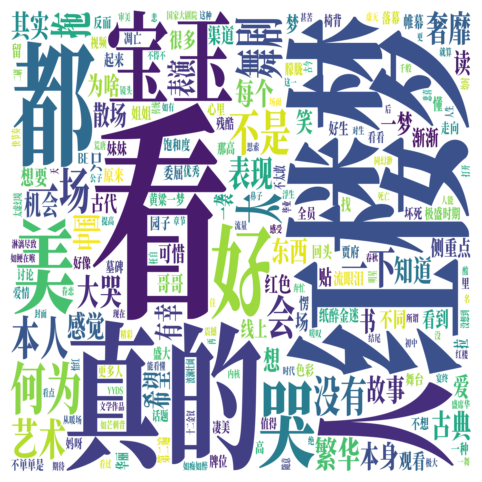

In [6]:

mask_image = Image.open("enlarged_image.png")
mask_array = np.array(mask_image)
# 生成词云
wordcloud = WordCloud(font_path="猴尊宋体.ttf",background_color="white",width=1800,height=1800, margin=5).generate_from_frequencies(word_freq)
#wordcloud = WordCloud(font_path="猴尊宋体.ttf",background_color="white",mask=mask_array,width=1800,height=1800, margin=5).generate_from_frequencies(word_freq)
# 显示词云图
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [7]:
wordcloud.to_file("wordcloud_ningji.png")

In [7]:
wordcloud.to_file("work_nlp.png")

In [42]:
mask_array

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

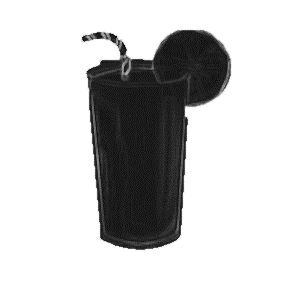

In [40]:
mask_image

In [38]:
df = pd.DataFrame(list(word_freq.items()), columns=['词语', '频率'])

# 保存为CSV文件
df.to_csv('word_freq.csv', index=False, encoding='utf-8-sig')

In [67]:
from PIL import Image

# 打开原始图片
original_image = Image.open("图片3.png")

# 将图片等比例放大到1800x1800像素
resized_image = original_image.resize((1800, 1800), Image.ANTIALIAS)

# 创建一个1800x1800的白色背景图片
background = Image.new('RGB', (1800, 1800), (255, 255, 255))

# 将放大后的图片粘贴到白色背景图片上
x = (1800 - resized_image.width) // 2
y = (1800 - resized_image.height) // 2
background.paste(resized_image, (x, y))

# 保存放大后的图片
background.save("enlarged_image.png")


C:\Users\Administrator\AppData\Local\Temp\ipykernel_16876\2240991497.py:7: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resized_image = original_image.resize((1800, 1800), Image.ANTIALIAS)


In [11]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 28, 18
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
import itertools
import warnings
warnings.filterwarnings("ignore")
plt.rcParams['font.sans-serif'] = ['SimHei'] #用来正常显示中文标签

# 读取 xlsx 文件
#df = pd.read_excel('D:/市调/数据终版/linlee贴子每日数据大.xlsx',index_col=0, header=0)
df = pd.read_excel('D:/市调/数据终版/linlee贴子每月数据.xlsx',index_col=0, header=0)
# 显示数据的前几行
print(df.head())


         评论数
时间          
2021-06   14
2021-07   26
2021-08   81
2021-09   81
2021-10   70


In [12]:
df.index = pd.to_datetime(df.index)
mte = df

In [11]:

mte[0:100]

,评论数
2021-06-01,1
2021-06-02,1
2021-06-03,1
2021-06-04,1
2021-06-05,1
...,...
2021-09-04,6
2021-09-05,9
2021-09-06,4
2021-09-07,3


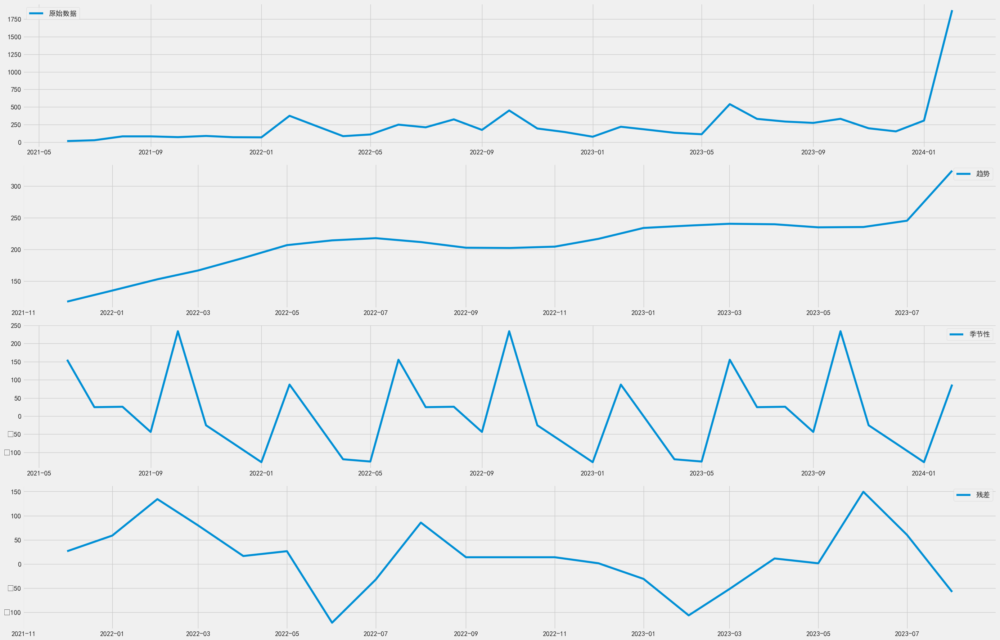

In [13]:
#分解趋势、季节、随机效应
decomposition = seasonal_decompose(mte[0:100], model='additive')
trend = decomposition.trend #趋势效应
seasonal = decomposition.seasonal #季节效应
residual = decomposition.resid #随机效应
plt.subplot(411)
plt.plot(mte, label=u'原始数据')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label=u'趋势')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label=u'季节性')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label=u'残差')
plt.legend(loc='best')
plt.tight_layout()
plt.savefig('季节性')

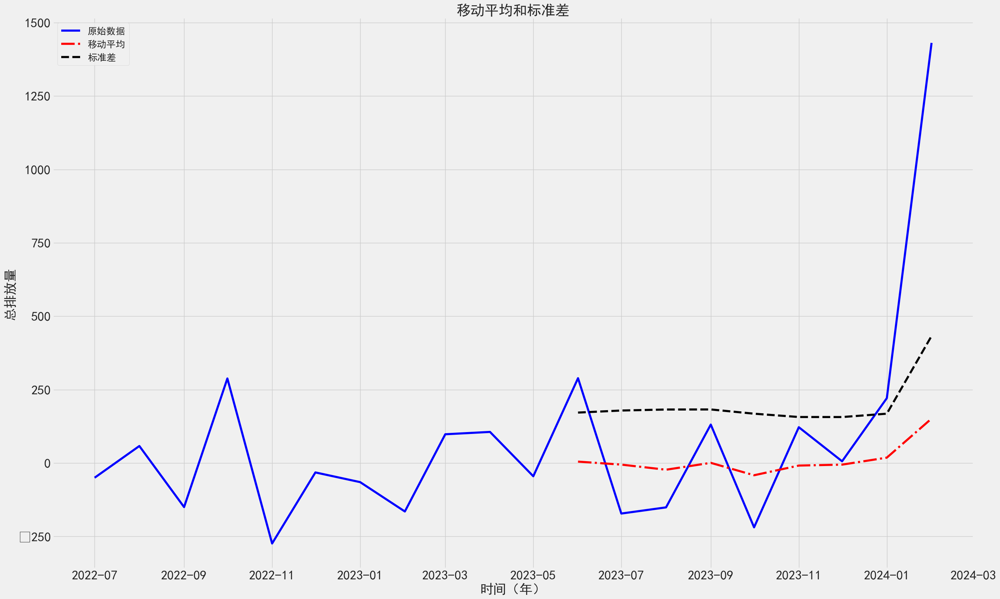

Test Statistic                  0.217636
p-value                         0.973234
#Lags Used                      7.000000
Number of Observations Used    12.000000
Critical Value (1%)            -4.137829
Critical Value (5%)            -3.154972
Critical Value (10%)           -2.714477
dtype: float64
不能拒绝原假设，即数据存在单位根,数据是非平稳序列。


In [14]:

def TestStationaryPlot(ts):
    rol_mean = ts.rolling(window = 12, center = False).mean()
    rol_std = ts.rolling(window = 12, center = False).std()

    plt.plot(ts, color = 'blue',label = u'原始数据')
    plt.plot(rol_mean, color = 'red', linestyle='-.', label = u'移动平均')
    plt.plot(rol_std, color ='black', linestyle='--', label = u'标准差')
    plt.xticks(fontsize = 25)
    plt.yticks(fontsize = 25)

    plt.xlabel(u'时间（年）', fontsize = 25)
    plt.ylabel(u'总排放量', fontsize = 25)
    plt.legend(loc='best', fontsize = 18)
    plt.title(u'移动平均和标准差', fontsize = 27)
    plt.show(block= True)
def TestStationaryAdfuller(ts, cutoff = 0.01):
    ts_test = adfuller(ts, autolag = 'AIC')
    ts_test_output = pd.Series(ts_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])

    for key,value in ts_test[4].items():
        ts_test_output['Critical Value (%s)'%key] = value
    print(ts_test_output)

    if ts_test[1] <= cutoff:
        print(u"拒绝原假设，即数据没有单位根,序列是平稳的。")
    else:
        print(u"不能拒绝原假设，即数据存在单位根,数据是非平稳序列。")
#消除消除趋势和季节性
mte_first_difference = mte - mte.shift(1) #一阶差分
mte_seasonal_first_difference = mte_first_difference - mte_first_difference.shift(12) #12步差分  
TestStationaryPlot(mte_seasonal_first_difference.dropna(inplace=False))
TestStationaryAdfuller(mte_seasonal_first_difference.dropna(inplace=False))

In [15]:

#白噪声检验
mte_seasonal_first_difference.dropna(inplace = True)
r,q,p = sm.tsa.acf(mte_seasonal_first_difference.values.squeeze(), qstat=True) 
data = np.c_[range(1,30), r[1:], q, p] 
table = pd.DataFrame(data, columns=['lag', "AC", "Q", "Prob(>Q)"]) 
print(table.set_index('lag'))

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 29 and the array at index 1 has size 13

ValueError: could not broadcast input array from shape (7,) into shape (41,)

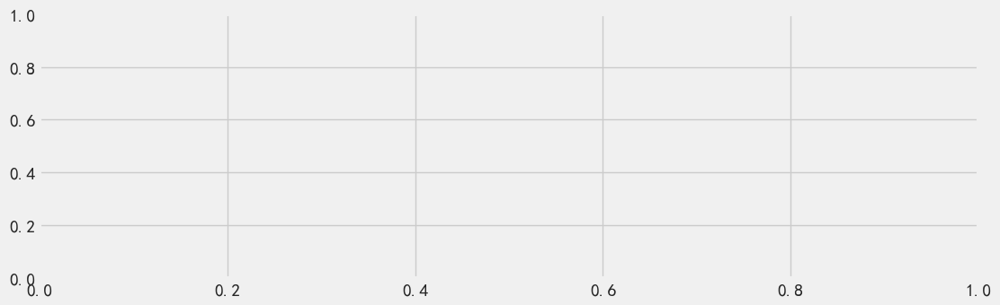

In [16]:
#寻找最优参数，建立SARIMA模型
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(mte_seasonal_first_difference.iloc[13:], lags=40, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(mte_seasonal_first_difference.iloc[13:], lags=40, ax=ax2)
plt.show()

In [17]:
import itertools
p = d = q = range(0, 2) 
pdq = list(itertools.product(p, d, q)) 
pdq_x_PDQs = [(x[0], x[1], x[2], 7) for x in list(itertools.product(p, d, q))] 
a=[]
b=[]
c=[]
wf=pd.DataFrame()
for param in pdq:
    for seasonal_param in pdq_x_PDQs:
        try:
            mod = sm.tsa.statespace.SARIMAX(mte,order=param,seasonal_order=seasonal_param,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{} - AIC:{}'.format(param, seasonal_param, results.aic))
            a.append(param)
            b.append(seasonal_param)
            c.append(results.aic)
        except:
            continue
wf['pdq']=a
wf['pdq_x_PDQs']=b
wf['aic']=c
print(wf[wf['aic']==wf['aic'].min()])

ARIMA(0, 0, 0)x(0, 0, 0, 7) - AIC:476.8863129641778
ARIMA(0, 0, 0)x(0, 0, 1, 7) - AIC:377.01171688958067
ARIMA(0, 0, 0)x(0, 1, 0, 7) - AIC:367.0421643538754
ARIMA(0, 0, 0)x(0, 1, 1, 7) - AIC:893.2601110721239
ARIMA(0, 0, 0)x(1, 0, 0, 7) - AIC:381.8329357888517
ARIMA(0, 0, 0)x(1, 0, 1, 7) - AIC:370.0451504927919
ARIMA(0, 0, 0)x(1, 1, 0, 7) - AIC:285.46599135559524
ARIMA(0, 0, 0)x(1, 1, 1, 7) - AIC:840.6967698089167
ARIMA(0, 0, 1)x(0, 0, 0, 7) - AIC:457.9442759719101
ARIMA(0, 0, 1)x(0, 0, 1, 7) - AIC:362.3909405141155
ARIMA(0, 0, 1)x(0, 1, 0, 7) - AIC:354.0324519949504
ARIMA(0, 0, 1)x(0, 1, 1, 7) - AIC:731.0795965772304
ARIMA(0, 0, 1)x(1, 0, 0, 7) - AIC:381.9893789345417
ARIMA(0, 0, 1)x(1, 0, 1, 7) - AIC:355.36836383416335
ARIMA(0, 0, 1)x(1, 1, 0, 7) - AIC:286.4225398302721
ARIMA(0, 0, 1)x(1, 1, 1, 7) - AIC:734.0227547716174
ARIMA(0, 1, 0)x(0, 0, 0, 7) - AIC:447.1005859864331
ARIMA(0, 1, 0)x(0, 0, 1, 7) - AIC:351.9899524496671
ARIMA(0, 1, 0)x(0, 1, 0, 7) - AIC:361.4092433437254
ARIMA(0, 

In [18]:

#LB检验
r,q,p = sm.tsa.acf(results.resid.values.squeeze(), qstat=True) 
data = np.c_[range(1,31), r[1:], q, p] 
table = pd.DataFrame(data, columns=['lag', "AC", "Q", "Prob(>Q)"]) 
print(table.set_index('lag'))

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 30 and the array at index 1 has size 15

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot
from statsmodels.graphics.tsaplots import plot_acf
# 创建示例时间序列数据
np.random.seed(123)
#data = pd.Series(np.random.randn(100), index=pd.date_range(start='2022-01-01', periods=100, freq='D'))
data = df['评论数']
# 拟合SARIMA模型
model = sm.tsa.statespace.SARIMAX(data, order=(1, 1, 1), seasonal_order=(0, 1, 1, 90)) 
# seasonal_order参数中，第一个季节周期性的阶数，第二个为差分阶数，第三个是移动平均阶数，第四个是季节周期数
results = model.fit()

# 检查残差
residuals = results.resid

In [20]:

#模型检验
#模型诊断
results.plot_diagnostics(figsize=(15, 12))
#plt.savefig('1234.png') 
plt.show()

ValueError: Length of endogenous variable must be larger the the number of lags used in the model and the number of observations burned in the log-likelihood calculation.

<Figure size 1500x1200 with 0 Axes>

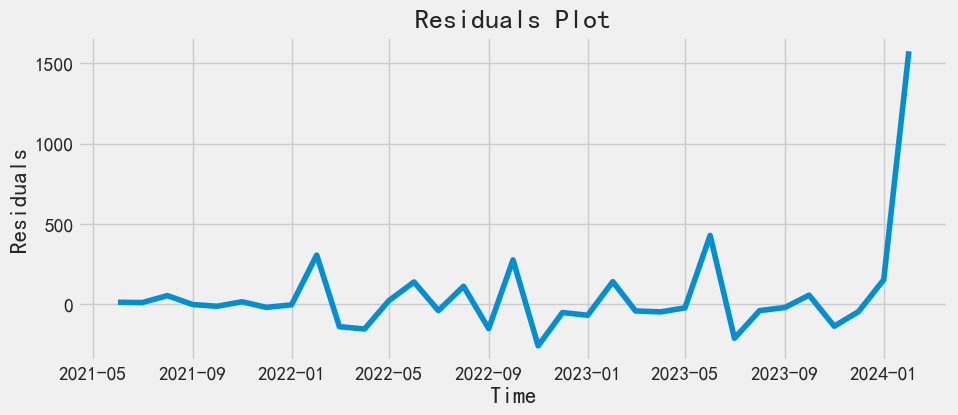

<Figure size 1000x400 with 0 Axes>

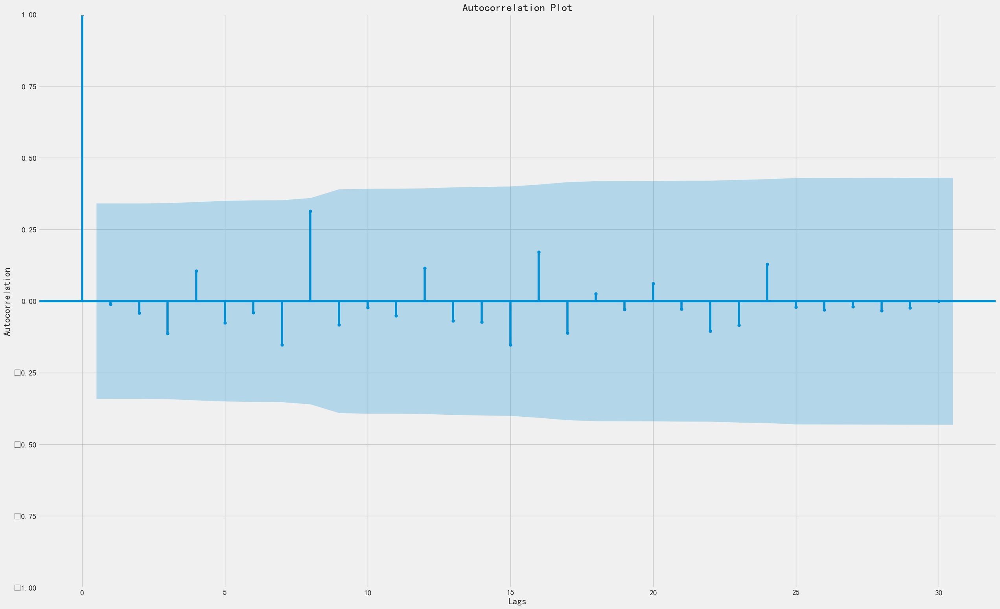

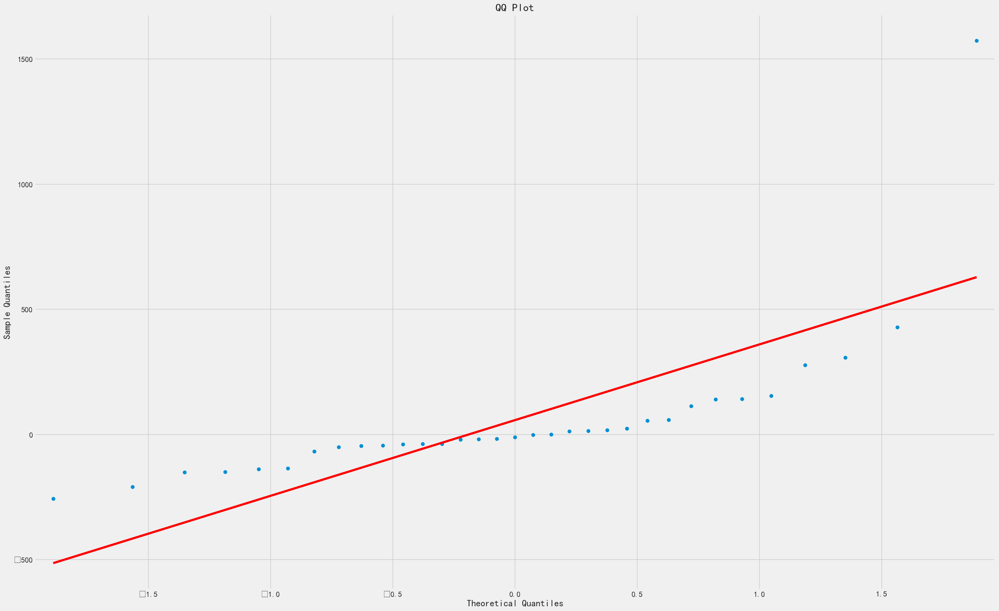

In [21]:

# 绘制残差图
plt.figure(figsize=(10, 4))
plt.plot(residuals)
plt.title('Residuals Plot')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.savefig('Residuals Plot.png') 
plt.show()

# 自相关检查
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title('Autocorrelation Plot')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.savefig('Autocorrelation Plot.png') 
plt.show()

# 正态性检查
sm.qqplot(residuals, line='s')
plt.title('QQ Plot')
plt.savefig('QQ Plot.png') 
plt.show()


In [22]:
print("\n异常值检查：")
mean_res = np.mean(residuals)
std_res = np.std(residuals)
threshold = 3  # 设置阈值为3个标准差
outliers = (residuals - mean_res).abs() > threshold * std_res
residuals[outliers]


异常值检查：


时间
2024-02-01    1573.0
dtype: float64

In [34]:
residuals[outliers]


2021/10/30    11.905183
2023/3/24     14.800804
2023/3/31     19.674964
2023/7/13     19.769419
2023/7/26     26.982943
2023/8/7      24.809818
2023/8/22     25.677585
dtype: float64

In [51]:
ind = residuals[outliers].index
result = df.loc[ind]
result

,评论数
2021/10/30,16
2022/11/28,19
2023/3/24,23
2023/3/31,28
2023/7/13,30
2023/7/26,41
2023/8/7,40
2023/8/22,43
2023/8/24,6
2024/2/13,17


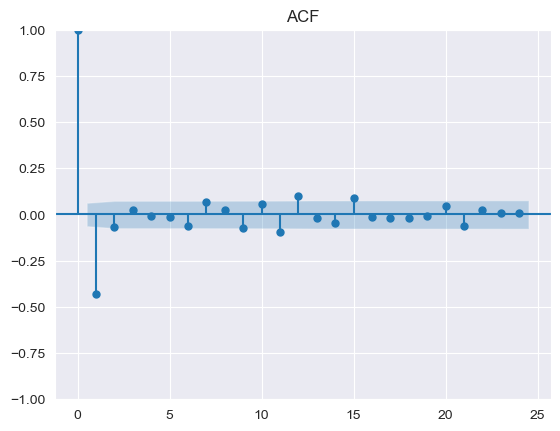

In [4]:
data_diff = df.diff().dropna()

# ACF和PACF图
plot_acf(data_diff, lags=24)
plt.title('ACF')
plt.show()

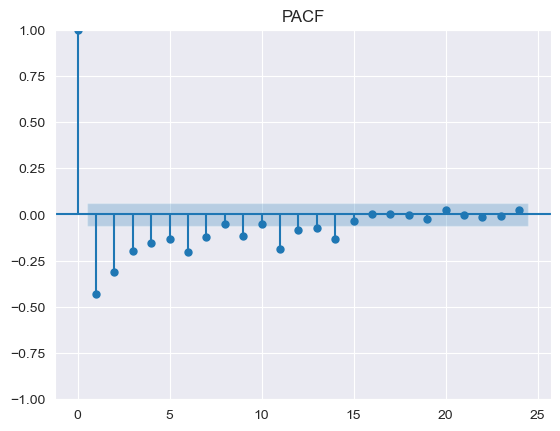

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
plot_pacf(data_diff, lags=24)
plt.title('PACF')
plt.show()

C:\Users\Administrator\AppData\Local\Temp\ipykernel_11040\2442101825.py:5: UserWarning: Glyph 35780 (\N{CJK UNIFIED IDEOGRAPH-8BC4}) missing from current font.
  plt.savefig('daily_airline_passengers.png')
C:\Users\Administrator\AppData\Local\Temp\ipykernel_11040\2442101825.py:5: UserWarning: Glyph 35770 (\N{CJK UNIFIED IDEOGRAPH-8BBA}) missing from current font.
  plt.savefig('daily_airline_passengers.png')
C:\Users\Administrator\AppData\Local\Temp\ipykernel_11040\2442101825.py:5: UserWarning: Glyph 25968 (\N{CJK UNIFIED IDEOGRAPH-6570}) missing from current font.
  plt.savefig('daily_airline_passengers.png')
D:\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 35780 (\N{CJK UNIFIED IDEOGRAPH-8BC4}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
D:\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 35770 (\N{CJK UNIFIED IDEOGRAPH-8BBA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
D:\A

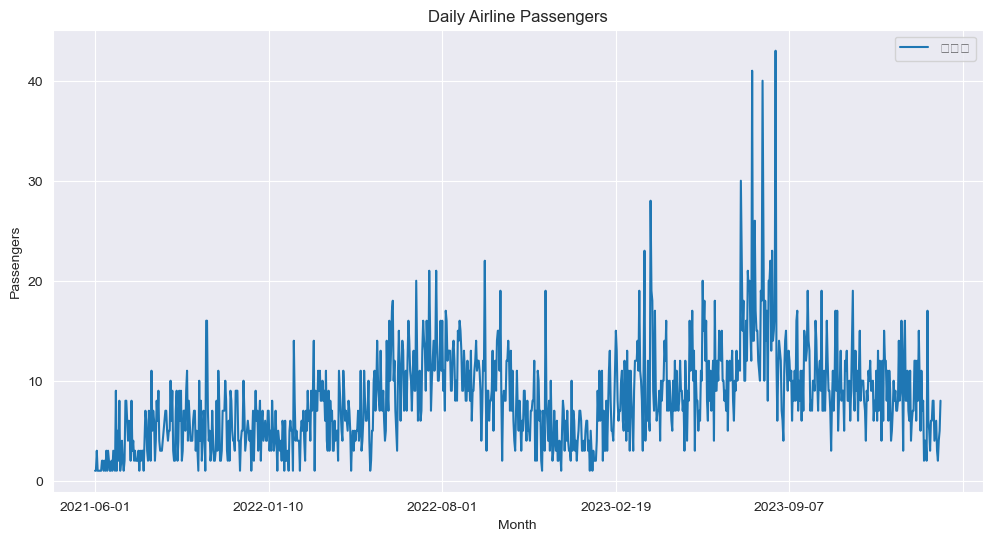

In [15]:
df.plot(figsize=(12, 6))
plt.xlabel('Month')
plt.ylabel('Passengers')
plt.title('Daily Airline Passengers')
plt.savefig('daily_airline_passengers.png') 


In [12]:
import matplotlib.pyplot as plt
fig = plt.figure()
fig.savefig('Daily Airline Passengers.png')

<Figure size 640x480 with 0 Axes>

In [8]:
decomposition = seasonal_decompose(df, model='additive')
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

ValueError: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None

In [20]:
mte = df
#分解趋势、季节、随机效应
decomposition = seasonal_decompose(mte)
trend = decomposition.trend #趋势效应
seasonal = decomposition.seasonal #季节效应
residual = decomposition.resid #随机效应
plt.subplot(411)
plt.plot(mte, label=u'原始数据')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label=u'趋势')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label=u'季节性')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label=u'残差')
plt.legend(loc='best')
plt.tight_layout()

ValueError: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None

In [19]:
df

,评论数
2021-06-01,1
2021-06-05,1
2021-06-06,3
2021-06-11,1
2021-06-14,1
...,...
2024-02-24,3
2024-02-25,2
2024-02-26,4
2024-02-27,5


In [18]:
df.index.freq = 'D'

In [22]:

# 或者直接在读取数据时将日期时间列解析为日期时间索引
#df = pd.read_csv('your_data.csv', parse_dates=['Date'], index_col='Date')
df = pd.read_excel('D:/市调/数据终版/linlee贴子每日数据大.xlsx', parse_dates=['Date'], index_col='Date')
df['Date'] = pd.to_datetime(df['Date'])
df.set_index('Date', inplace=True)
# 确保索引的频率设置正确
# 例如，如果你的数据是每日数据，你可以设置频率为'D'
df.index.freq = 'D'


ValueError: Missing column provided to 'parse_dates': 'Date' (sheet: 0)

In [13]:

r,q,p = sm.tsa.acf(results.resid.values.squeeze(), qstat=True) 
data = np.c_[range(1,31), r[1:], q, p] 
table = pd.DataFrame(data, columns=['lag', "AC", "Q", "Prob(>Q)"]) 
print(table.set_index('lag'))

NameError: name 'results' is not defined

In [42]:
r

array([ 1.00000000e+00, -1.61360513e-02, -1.60719674e-02,  9.78471932e-03,
       -3.64646110e-02, -4.96041687e-02, -4.99682986e-02,  4.68051179e-02,
        3.03469176e-02, -5.24444861e-02, -9.65895252e-03, -6.02670414e-02,
        9.54360412e-02,  9.38858437e-03,  4.24918325e-02,  1.25908150e-01,
        4.56225493e-02, -2.05706056e-02, -1.67633546e-02, -3.25458498e-04,
        1.21088949e-02, -2.90749625e-02, -8.45373628e-07,  6.27252938e-03,
        3.18940316e-03, -2.36693042e-02, -2.38191512e-02,  6.90765525e-02,
       -4.05931051e-03,  1.14142445e-02, -2.33238201e-02])

In [53]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# 1. 读取数据
data = pd.read_excel("D:/市调/代码/257130015_按序号_LINLEE柠檬茶品牌调研分析及新品开发机会点挖掘——基于上海市_150_150.xlsx",header=0)
data

,序号,提交答卷时间,所用时间,来源,来源详情,来自IP,1、您的性别:,2、您的年龄:,3、您的职业:,4、您的月消费水平:,...,35、(因为LINLEE的网红鸭子),35、(有喜欢的明星代言),35、(其他),36、如果您愿意了解 LINLEE 这个品牌，您会通过什么渠道寻找更多信息?（多选）(在网上搜索品牌信息),36、(阅读消费者评价和评论),36、(前往品牌官方网站了解详情),36、(寻找相关新闻报道或评测),36、(向朋友或家人询问),36、(其他（请注明）),总分
0,1,2024/3/8 23:00:24,225秒,微信,NaN,101.82.162.165(上海-上海),1,2,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,113
1,2,2024/3/8 23:15:15,119秒,微信,NaN,140.206.176.129(上海-上海),1,2,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,62
2,3,2024/3/8 23:29:44,155秒,微信,NaN,180.160.207.234(上海-上海),2,2,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,146
3,4,2024/3/9 10:55:46,94秒,手机提交,直接访问,180.160.207.234(上海-上海),1,2,6,4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65
4,5,2024/3/9 11:12:28,99秒,微信,NaN,218.95.7.67(江西-南昌),1,2,1,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,81
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,146,2024/3/10 20:08:46,119秒,微信,NaN,180.160.209.186(上海-上海),2,2,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60
146,147,2024/3/10 20:34:07,1931秒,微信,NaN,116.246.2.42(上海-上海),2,2,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,119
147,148,2024/3/10 21:17:10,42秒,微信,NaN,58.37.194.181(上海-上海),2,2,1,2,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0
148,149,2024/3/10 21:28:42,109秒,微信,NaN,180.162.63.125(上海-上海),2,3,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,160


In [54]:


# 2. 数据探索与准备
# 假设数据中包含了性别、年龄、职业、月消费水平、现居地和是否购买过LINLEE柠檬茶的信息
# 选择合适的列作为特征 X 和目标变量 y
X = data[['1、您的性别:', '2、您的年龄:', '3、您的职业:', '4、您的月消费水平:', '5、您的现居地:']]
y = data['7、您是否购买过LINLEE柠檬茶？']

# 3. 数据预处理
# 对分类变量进行独热编码
#X_encoded = pd.get_dummies(X)

# 4. 拆分数据集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 5. 训练逻辑回归模型
model = LogisticRegression()
model.fit(X_train, y_train)

# 6. 评估模型
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("模型准确率：", accuracy)

# 7. 模型应用
# 可以使用训练好的模型对新数据进行预测


模型准确率： 0.6
